# Sampled Music Detection Based on DTW

**Task**: Given two songs, we tell that one samples from another, what has been taken, and where the sample has been placed.

In [1]:
import os
import sys
import numpy as np
import librosa
from numba import jit
import matplotlib.pyplot as plt
from matplotlib import patches
from dtaidistance import dtw
from pydub import AudioSegment

import libfmp.b
import libfmp.c3
import libfmp.c7

In [2]:
def segment(sig, start=0.0, duration=10.0):
    start = int(start*Fs)
    duration = int(duration*Fs)
    return sig[start: start+duration]

In [3]:
file_1 = "pumpit.wav"
file_2 = "misirlou.wav"
data_dir = ""

In [4]:
Fs = 22050
N_feat = 4410
H_feat = 2205

fn1 = os.path.join(data_dir, file_1)
fn2 = os.path.join(data_dir, file_2)

x1, Fs = librosa.load(fn1, sr=Fs)

##This song starts a little later, when there are lots of noises it is very bad to get the similarities
x1 = segment(x1, start=12.0, duration=213.0)

x2, Fs = librosa.load(fn2, sr=Fs)
duration = librosa.get_duration(y=x1, sr=Fs)

In [5]:
import IPython.display as ipd
ipd.Audio(data=x1, rate=Fs)

In [6]:
ipd.Audio(data=x2, rate=Fs)

## Preprocessing
DTW on the time domain:

We split song A into 1-second fragments, and choose the fragment with the least distance to song B

In [7]:
def DTW_cost_matrix(x1_audio, x2_audio, sample_rate, ell=21, d=5):
    N_feat = 4410
    H_feat = 2205
    # ell: smoothing size
    # d: downsample rate
    C1 = librosa.feature.chroma_stft(y=x1_audio, sr=sample_rate, tuning=0, norm=None, hop_length=H_feat, n_fft=N_feat) # 12 chroma bins * time frames with frame size = hopsize / Fs
    C2 = librosa.feature.chroma_stft(y=x2_audio, sr=sample_rate, tuning=0, norm=None, hop_length=H_feat, n_fft=N_feat)
    
    X, Fs_cens = libfmp.c7.compute_cens_from_chromagram(C1, ell=ell, d=d)
    Y, Fs_cens = libfmp.c7.compute_cens_from_chromagram(C2, ell=ell, d=d)
    N, M = X.shape[1], Y.shape[1]
    
    C_FMP = libfmp.c3.compute_cost_matrix(X, Y, 'euclidean')
    return C_FMP

In [8]:
C = DTW_cost_matrix(x1, x2, Fs, ell=24, d=5)

In [9]:
N_feat = 4410
H_feat = 2205
t1 = np.where(C==np.min(C))[0][0]*5*H_feat/Fs
t2 = np.where(C==np.min(C))[1][0]*5*H_feat/Fs
print(t1, t2)

2.5 2.5


## DTW Based Matching: finding the optimal subsequence

- Given two feature sequences, we need to find a subsequence within the longer sequence that optimally fits the shorter one
- We take Chroma features as feature sequences

In [10]:
def DTW_matching(x1, x2, ell=21, d=5):
    # ell: smoothing size
    # d: downsample rate
    C1 = librosa.feature.chroma_stft(y=x1, sr=Fs, tuning=0, norm=None, hop_length=H_feat, n_fft=N_feat) # 12 chroma bins * time frames with frame size = hopsize / Fs
    C2 = librosa.feature.chroma_stft(y=x2, sr=Fs, tuning=0, norm=None, hop_length=H_feat, n_fft=N_feat)
    
    X, Fs_cens = libfmp.c7.compute_cens_from_chromagram(C1, ell=ell, d=d)
    Y, Fs_cens = libfmp.c7.compute_cens_from_chromagram(C2, ell=ell, d=d)
    N, M = X.shape[1], Y.shape[1]
    
    C_FMP = libfmp.c3.compute_cost_matrix(X, Y, 'euclidean')
    sigma = np.array([[1, 0], [0, 1], [1, 1]])
    D_librosa, P_librosa = librosa.sequence.dtw(C=C_FMP, step_sizes_sigma=sigma, subseq=True, backtrack=True)
    P_librosa = P_librosa[::-1, :]
    
    return D_librosa, P_librosa

In [11]:
def plot_DTW_path(D_librosa, P_librosa):
    # plot
    cmap = libfmp.b.compressed_gray_cmap(alpha=-10, reverse=True)
    fig, ax = plt.subplots(figsize=(15, 5))
    # title='LibROSA implementation with step size condition $\Sigma=\{(1, 0), (0, 1), (1, 1)\}$'
    libfmp.c3.plot_matrix_with_points(D_librosa, P_librosa, ax=[ax], cmap=cmap, 
                                      xlabel=f'Sequence Y ({file_2})', ylabel=f'Sequence X ({file_1})', 
                                      # title=title,
                                      marker='o', linestyle='-')
    ax.set_title("DTW Optimal Warping Path")

In [12]:
ell = 21
d = 5
fragment = segment(x1, t1)
D_librosa, P_librosa = DTW_matching(fragment, x2, ell, d)

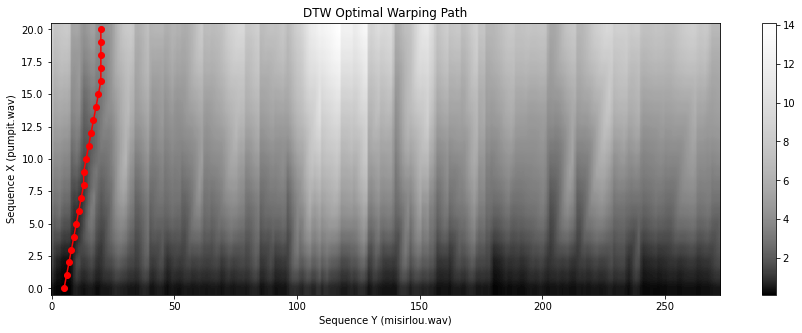

In [13]:
plot_DTW_path(D_librosa, P_librosa)

### DTW Optimal Subsequence

In [14]:
def DTW_subsequence(D_librosa, P_librosa):
    # Subsequence DTW
    N = D_librosa.shape[0]
    Delta_DTW = D_librosa[-1, :] / N # matching function
    a_ast = P_librosa[0, 1]
    b_ast = P_librosa[-1, 1]
    return Delta_DTW, a_ast, b_ast

In [15]:
def plot_DTW_subsequence(Delta_DTW, a_ast, b_ast):
    fig, ax = plt.subplots(figsize=(15, 5))
    libfmp.b.plot_signal(Delta_DTW, ax=ax, xlabel='Time (samples)', ylabel='', ylim=[0, 5],
                         title=r'Matching function $\Delta_\mathrm{DTW}$', color='k')
    ax.set_xlim([-0.5, len(Delta_DTW)-0.5])
    ax.grid()
    ax.plot(b_ast, Delta_DTW[b_ast], 'ro')
    ax.add_patch(patches.Rectangle((a_ast-0.5, 0), b_ast-a_ast+1, 7, facecolor='r', alpha=0.2))

In [16]:
Delta_DTW, a_ast, b_ast = DTW_subsequence(D_librosa, P_librosa)

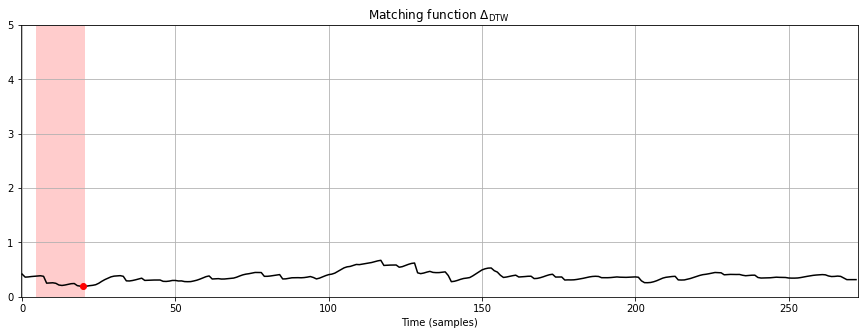

In [17]:
plot_DTW_subsequence(Delta_DTW, a_ast, b_ast)

## Result: Sampled fragment

In [18]:
init_frame = a_ast*d
end_frame = b_ast*d
sample = x2[init_frame*H_feat:end_frame*H_feat]
ipd.Audio(data=sample, rate=Fs)

In [19]:
ipd.Audio(data=fragment, rate=Fs)

# Evaluation

In [20]:
distance = dtw.distance_fast(sample.astype('double'), fragment.astype('double'))
print(distance)

57.37987458743329


In [21]:
noice = np.random.normal(size=len(x1))
x1_ = x1 + 0.1*noice

In [22]:
C = DTW_cost_matrix(x1_, x2, Fs, ell=24, d=5)

In [23]:
N_feat = 4410
H_feat = 2205
t1 = np.where(C==np.min(C))[0][0]*5*H_feat/Fs
t2 = np.where(C==np.min(C))[1][0]*5*H_feat/Fs
print(t1, t2)

169.5 9.0


In [24]:
ell = 21
d = 5
fragment = segment(x1_, t1, duration=20)
D_librosa, P_librosa = DTW_matching(fragment, x2, ell, d)

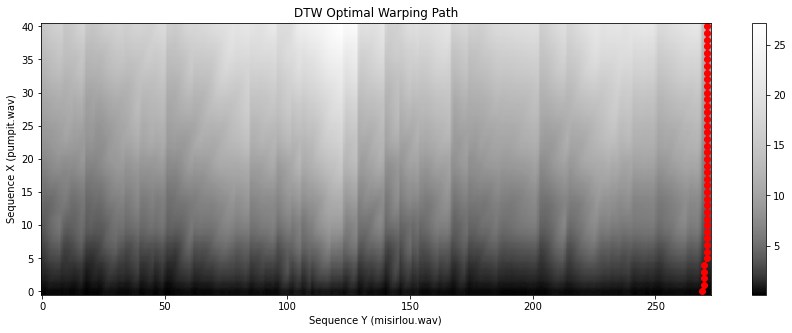

In [25]:
plot_DTW_path(D_librosa, P_librosa)

In [26]:
Delta_DTW, a_ast, b_ast = DTW_subsequence(D_librosa, P_librosa)

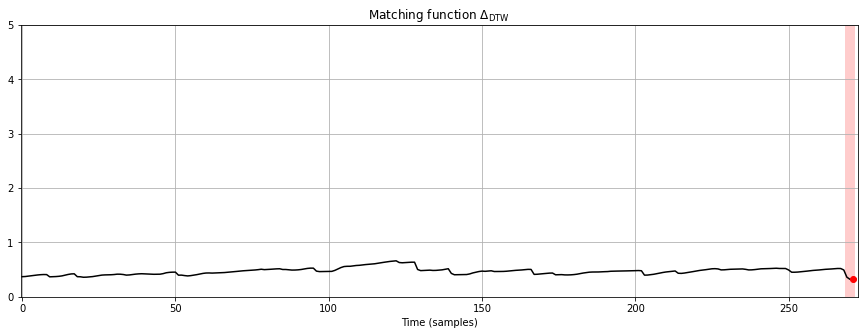

In [27]:
plot_DTW_subsequence(Delta_DTW, a_ast, b_ast)

In [28]:
init_frame = a_ast*d
end_frame = b_ast*d
sample = x2[init_frame*H_feat:end_frame*H_feat]
ipd.Audio(data=sample, rate=Fs)

C:\Users\tatia\anaconda3\lib\site-packages\IPython\lib\display.py:174: RuntimeWarning: invalid value encountered in true_divide
  scaled = data / normalization_factor * 32767


In [29]:
ipd.Audio(data=fragment, rate=Fs)

In [30]:
distance = dtw.distance_fast(sample.astype('double'), fragment.astype('double'))
print(distance)

207.35751589424373


In [31]:
#Tempo adjustment
sound = AudioSegment.from_file(fn1)

def speed_change(sound, speed=1.0):
    # Manually override the frame_rate. This tells the computer how many
    # samples to play per second
    sound_with_altered_frame_rate = sound._spawn(sound.raw_data, overrides={
         "frame_rate": int(sound.frame_rate * speed)
      })
     # convert the sound with altered frame rate to a standard frame rate
     # so that regular playback programs will work right. They often only
     # know how to play audio at standard frame rate (like 44.1k)
    return sound_with_altered_frame_rate.set_frame_rate(sound.frame_rate)


slow_sound = speed_change(sound, 3.5)

In [37]:
slow_s_x1 = slow_sound.get_array_of_samples() 
slow_s_x1 = np.array(slow_s_x1, dtype='float32')

slow_s_x1 = segment(slow_s_x1, start=15.0, duration=270.0)

In [38]:
ipd.Audio(data=slow_s_x1, rate=Fs)

In [49]:
C = DTW_cost_matrix(slow_s_x1, x2, Fs, ell=24, d=5)

In [50]:
N_feat = 4410
H_feat = 2205
t1 = np.where(C==np.min(C))[0][0]*5*H_feat/Fs
t2 = np.where(C==np.min(C))[1][0]*5*H_feat/Fs
print(t1, t2)

266.0 134.5


In [52]:
ell = 21
d = 5
fragment = segment(slow_s_x1, t1-20, duration=20)
D_librosa, P_librosa = DTW_matching(fragment, x2, ell, d)

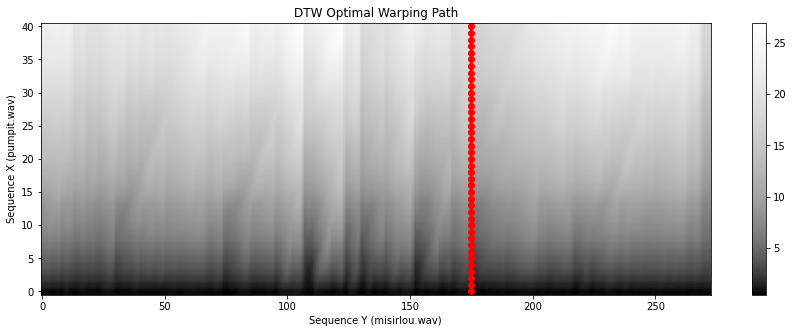

In [53]:
plot_DTW_path(D_librosa, P_librosa)

In [54]:
Delta_DTW, a_ast, b_ast = DTW_subsequence(D_librosa, P_librosa)

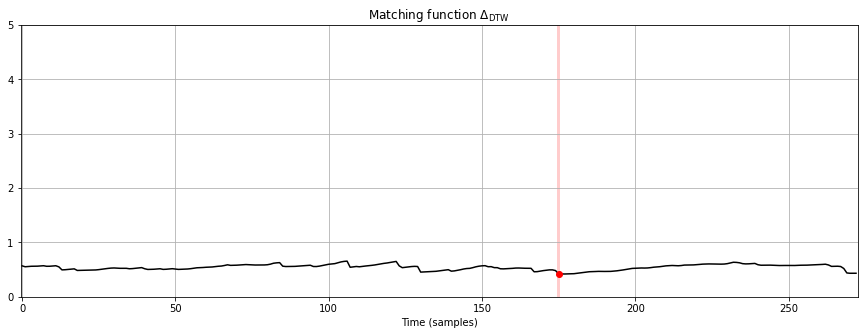

In [55]:
plot_DTW_subsequence(Delta_DTW, a_ast, b_ast)

In [56]:
init_frame = a_ast*d
end_frame = b_ast*d
sample = x2[init_frame*H_feat:end_frame*H_feat]
ipd.Audio(data=sample, rate=Fs)

ValueError: zero-size array to reduction operation maximum which has no identity

In [57]:
ipd.Audio(data=fragment, rate=Fs)

In [58]:
distance = dtw.distance_fast(sample.astype('double'), fragment.astype('double'))
print(distance)

IndexError: Out of bounds on buffer access (axis 0)